# Дневник работы
- Побитие бейслайна стандартной моделью - 1960.4
- Реализация кастомного лосса - не дало результата
- Генерация признаков
    - Удаление признаков с нулевыми шапами - 1959.3
    - Удаление `cont11` и добавление полиномиальных признаков над важными числовыми фичами - 1956.6 
- Интерпретация модели
    - Выделение важных и незначимых признаков (помогло в разделе "генерация признаков")
    - Построение эмбеддингов для объектов из метода `.trees_to_dataframe()` - 1947.6 на параметрах после тюнинга
- Понижение размерности - не дало результата
- Подбор гиперпараметров с кросс-валидацией и early stopping по кастомной метрике - 1948.1

## Бейслайн
Бьётся стандартной моделью LightGBM с обозначением кат. признаков

In [116]:
import numpy as np
import pandas as pd
import lightgbm as lgb

train = pd.read_csv('train_contest.csv')
train

,cat1,cat2,cat3,cat4,cat5,cat6,cat7,cat8,cat9,cat10,...,cont6,cont7,cont8,cont9,cont10,cont11,cont12,cont13,cont14,target
0,B,A,A,B,A,B,A,A,A,A,...,0.516811,0.512119,0.80058,0.44352,0.63026,0.705501,0.692256,0.516660,0.678592,2730.63
1,A,B,A,A,A,A,A,B,B,A,...,0.499177,0.443760,0.43518,0.66201,0.57716,0.644013,0.630853,0.354344,0.236668,1430.29
2,B,B,A,A,A,B,A,A,B,A,...,0.818056,0.575090,0.66201,0.64681,0.68039,0.863052,0.879347,0.820538,0.714493,2422.54
3,A,A,A,B,A,A,A,A,A,A,...,0.317225,0.485598,0.49462,0.38448,0.34424,0.644013,0.630853,0.206416,0.360832,2910.93
4,A,B,A,A,A,A,A,A,B,B,...,0.380128,0.327516,0.41762,0.43524,0.42284,0.415029,0.406090,0.372852,0.283021,4305.19
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
120089,A,B,A,A,A,A,A,A,B,B,...,0.711174,0.589613,0.56011,0.53565,0.47225,0.492200,0.481306,0.773235,0.280743,2779.32
120090,A,B,A,A,A,A,A,A,B,B,...,0.277229,0.351637,0.26847,0.39447,0.37493,0.453334,0.443374,0.310026,0.382517,698.18
120091,A,B,A,B,B,A,B,B,B,B,...,0.844563,0.530467,0.97973,0.93383,0.83814,0.832976,0.832658,0.810511,0.806941,23583.06
120092,B,B,A,A,A,A,A,A,B,A,...,0.321058,0.326430,0.31280,0.39648,0.38016,0.245410,0.241676,0.261150,0.473558,1304.32


In [ ]:
features = list(train.drop('target', axis=1).columns)

cat_features = []

for feature in features:
    if 'cat' in feature:
        cat_features.append(feature)
        train[feature] = train[feature].astype('category')

X_train, y_train = train[features], train.target

lgb_df = lgb.Dataset(data=X_train, label=y_train, categorical_feature=cat_features)

def custom_metric(
    predictions, 
    tr_data=None, 
    y_true=None,
    eps=100,
    alpha=1.2,
    beta=0.9,
    p=2
):
    if y_true is None:
        y_true = tr_data.get_label()
    
    loss = np.zeros(y_true.shape)
    greater_idx, less_idx = np.where(predictions > y_true + eps), np.where(predictions < y_true - eps)
    diff = predictions - y_true
    loss[greater_idx] = alpha * (np.abs(diff[greater_idx]) - eps) ** p 
    loss[less_idx] = beta * (np.abs(diff[less_idx]) - eps) ** p 
    return 'custom_metric', np.sqrt(loss.mean()), False


params = {
    'objective': 'regression',
}

model = lgb.train(
    train_set=lgb_df, 
    params=params, 
    valid_sets=[lgb_df],
    valid_names=['train'], 
    feval=custom_metric,
    callbacks=[lgb.log_evaluation(period=20)],
)

In [ ]:
X_test = pd.read_csv('test_contest.csv').drop('index', axis=1)
y_pred = model.predict(X_test)
pd.DataFrame(y_pred, columns=['target']).to_csv('base.csv', index=True, index_label='index')

## Реализация кастомного лосса
Метрика из задания уже реализована выше и используется при тюнинге гиперпараметров с early stopping. Теперь реализуем лосс:

In [174]:
def custom_grad_hess(y_raw, tr_data=None, y_true=None, alpha=1.2, beta=0.9, p=2, eps=100):
    if y_true is None:
        y_true = tr_data.get_label()

    N = y_true.shape
    grad, hess = np.zeros(N), np.zeros(N)
    greater_idx = np.where(y_raw > y_true + eps)
    less_idx = np.where(y_raw < y_true - eps)
    diff = y_raw - y_true
    grad[greater_idx] = alpha * p * (np.abs(diff[greater_idx]) - eps) ** (p - 1)
    grad[less_idx] = -beta * p * (np.abs(diff[less_idx]) - eps) ** (p - 1)
    hess[greater_idx] = alpha * p * (p - 1) * (np.abs(diff[greater_idx]) - eps) ** (p - 2)
    hess[less_idx] = beta * p * (p - 1) * (np.abs(diff[less_idx]) - eps) ** (p - 2)

    return grad, hess

In [ ]:
lgb_df = lgb.Dataset(data=X_train, label=y_train, categorical_feature=cat_features)

params = {
    'objective': custom_grad_hess,
}

model_wth_custom_loss_1 = lgb.train(
    train_set=lgb_df, 
    params=params, 
    valid_sets=[lgb_df],
    valid_names=['train'], 
    feval=custom_metric,
    callbacks=[lgb.log_evaluation(period=20)],
)

y_pred = model_wth_custom_loss_1.predict(X_test)
pd.DataFrame(y_pred, columns=['target']).to_csv('custom_loss.csv', index=True, index_label='index')

К сожалению, скор ухудшился (1986.7). Я также пробовал тюнить параметры `alpha`, `beta` и `eps` в кастомном лоссе, но это также выдавало результат хуже (1961.5), чем обычный лосс. 

Взглянем теперь на распределение логарифма таргета:

<Axes: xlabel='target', ylabel='Count'>

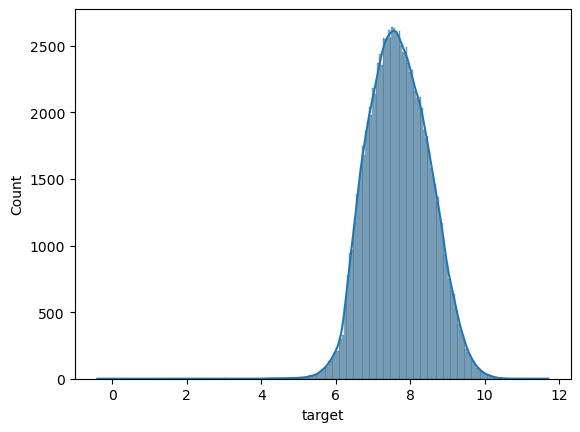

In [171]:
import seaborn as sns

sns.histplot(np.log(y_train), kde=True)

Картина получается более симметричной, и я попробовал сконструировать следующий лосс (смысл: это MSE от разности логарифмов):
$$L(y, \hat{y}) = \left(\log{y} - \log{\hat{y}}\right)^2.$$
$L'(y) = \dfrac{2 \log{\left(y/\hat{y}\right)}}{y},\quad L''(y) = \dfrac{2}{y^2} \cdot \left(1 - \log{\frac{y}{\hat{y}}}\right)$.

In [175]:
def another_custom_grad_hess(y_raw, tr_data=None, y_true=None):
    if y_true is None:
        y_true = tr_data.get_label() 

    epsilon = 1e-12
    y_raw = np.clip(y_raw, epsilon, None)
    diff = np.log(y_raw) - np.log(y_true)
    grad = 2 * diff / y_raw 
    hess = 2 * (1 - diff) / (y_raw ** 2)

    return grad, hess

In [ ]:
lgb_df = lgb.Dataset(data=X_train, label=y_train, categorical_feature=cat_features)

params = {
    'objective': another_custom_grad_hess,
}

model_wth_custom_loss_2 = lgb.train(
    train_set=lgb_df, 
    params=params, 
    valid_sets=[lgb_df],
    valid_names=['train'], 
    feval=custom_metric,
    callbacks=[lgb.log_evaluation(period=20)],
)

y_pred = model_wth_custom_loss_2.predict(X_test)
pd.DataFrame(y_pred, columns=['target']).to_csv('logarithm loss.csv', index=True, index_label='index')

Однако, обучение на данном лоссе также не дало положительных результатов.

## Интерпретация модели

Вычислим shap-значения:

In [121]:
shap_vals = model.predict(X_train, pred_contrib=True)

shap_df = pd.DataFrame({
    'feature': features,
    'median_shap': np.median(np.abs(shap_vals[:,:-1]), axis=0),
    'sum_shap': np.sum(np.abs(shap_vals[:,:-1]), axis=0),
})

pd.set_option('display.max_rows', 200)
shap_df.sort_values('median_shap', ascending=False)

,feature,median_shap,sum_shap
79,cat80,430.524406,7.666003e+07
99,cat100,218.878803,2.793348e+07
100,cat101,209.797789,3.339682e+07
78,cat79,191.744845,3.852312e+07
117,cont2,149.573502,2.744550e+07
111,cat112,144.179604,2.018734e+07
80,cat81,127.152961,2.435367e+07
71,cat72,116.861163,1.615563e+07
4,cat5,89.242428,1.112985e+07
11,cat12,89.152158,1.781584e+07


Как видно, есть много признаков с нулевыми шапами, то есть они никак не влияют на предсказания модели и их можно выкинуть.

## Отбор и генерация признаков

Нарисуем корреляционную матрицу для числовых признаков:

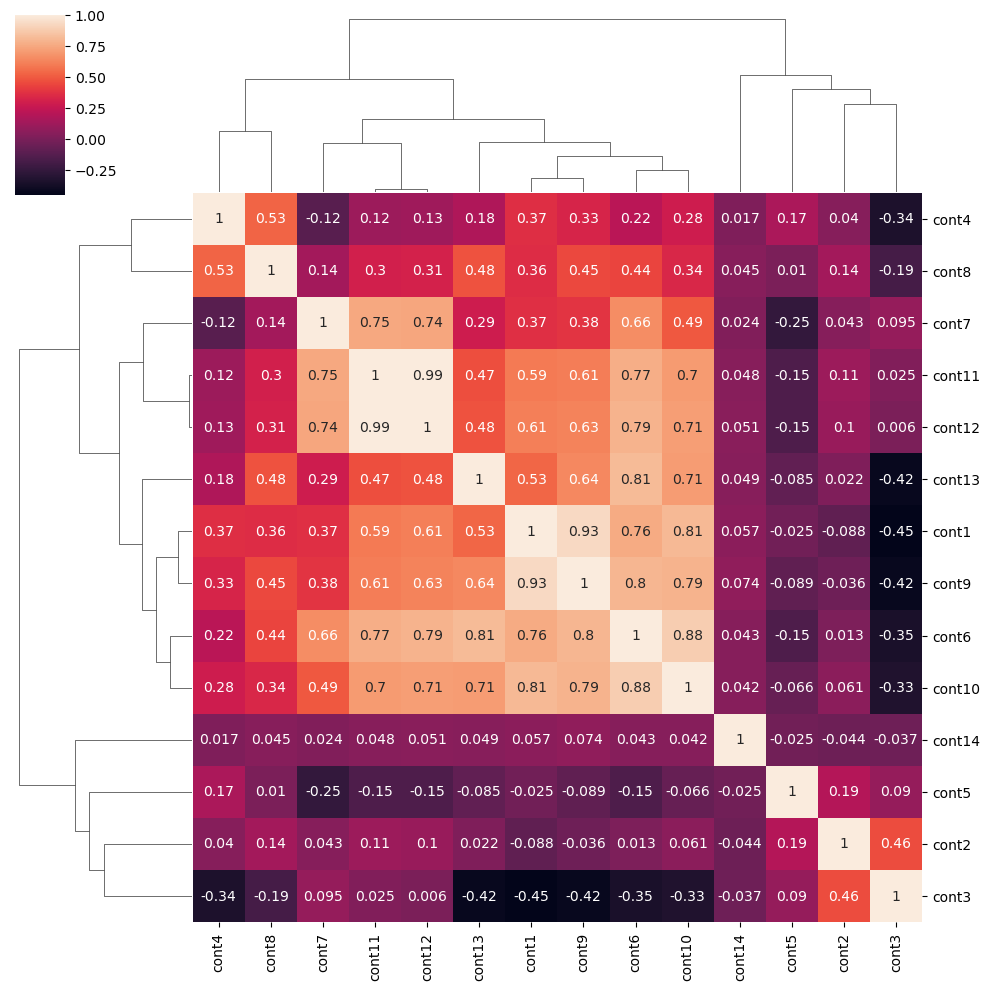

In [122]:
import seaborn as sns

num_features = []
for feat in features:
    if 'cont' in feat:
        num_features.append(feat)

sns.clustermap(X_train[num_features].corr(), annot=True)

Видно, что признаки `cont11` и `cont12` сильно коррелируют (0.99). Признак `cont11` менее значим (меньшее медианное значение модуля шапа), поэтому удалим его, а также уберём все признаки с нулевыми шапами, после чего сгенерируем полиномиальные признаки для самых важных числовых признаков: `cont2`, `cont7` и `cont12`.

In [133]:
features_to_throw = list(shap_df[np.isclose(shap_df.sum_shap, 0)]['feature']) + ['cont11']
new_X_train = X_train.drop(features_to_throw, axis=1)

from sklearn.preprocessing import PolynomialFeatures
from sklearn.compose import ColumnTransformer

polynomial = ColumnTransformer(
    transformers=[
        ('poly', PolynomialFeatures(degree=3, interaction_only=True, include_bias=False), ['cont2', 'cont7', 'cont12'])
    ],
    remainder='passthrough',
    verbose_feature_names_out=False
)

new_X_train = pd.DataFrame(polynomial.fit_transform(new_X_train), columns=polynomial.get_feature_names_out())

new_cat_features = []

for feat in new_X_train.columns:
    if 'cat' in feat:
        new_cat_features.append(feat)
        new_X_train[feat] = new_X_train[feat].astype('category')
    else:
        new_X_train[feat] = new_X_train[feat].astype('float')

In [ ]:
lgb_df = lgb.Dataset(data=new_X_train, label=y_train, categorical_feature=new_cat_features)

params = {
    'objective': 'regression',
}

model = lgb.train(
    train_set=lgb_df, 
    params=params, 
    valid_sets=[lgb_df],
    valid_names=['train'], 
    feval=custom_metric,
    callbacks=[lgb.log_evaluation(period=20)],
)

In [135]:
new_X_test = pd.DataFrame(polynomial.transform(X_test), columns=polynomial.get_feature_names_out())
for feat in new_X_train.columns:
    if 'cat' in feat:
        new_X_test[feat] = new_X_test[feat].astype('category')
    else:
        new_X_test[feat] = new_X_test[feat].astype('float')

In [ ]:
y_pred = model.predict(new_X_test)
pd.DataFrame(y_pred, columns=['target']).to_csv('new_feat.csv', index=True, index_label='index')

## Продолжение интерпретации

Получим эмбединги на основании деревьев из модели с полиномиальными признаками, и понизим их размерность, запустив `umap`.

In [137]:
from utils import extract_attr_by_leaf_matrix

leaf_df = model.trees_to_dataframe()
leaf_matrix = model.predict(new_X_train, pred_leaf=True)
train_emb = extract_attr_by_leaf_matrix(leaf_df, leaf_matrix, 'count')

In [138]:
import umap

mapper = umap.UMAP(
    n_neighbors=30,
    n_components=2,
)

new_emb = mapper.fit_transform(train_emb)

In [139]:
embs_df = pd.DataFrame({
    'x': new_emb[:,0],
    'y': new_emb[:,1],
    'color': np.median(train_emb, axis=1)
})

import plotly.express as px

fig = px.scatter(data_frame=embs_df, x='x', y='y', color='color')
fig.update_layout(width=800)

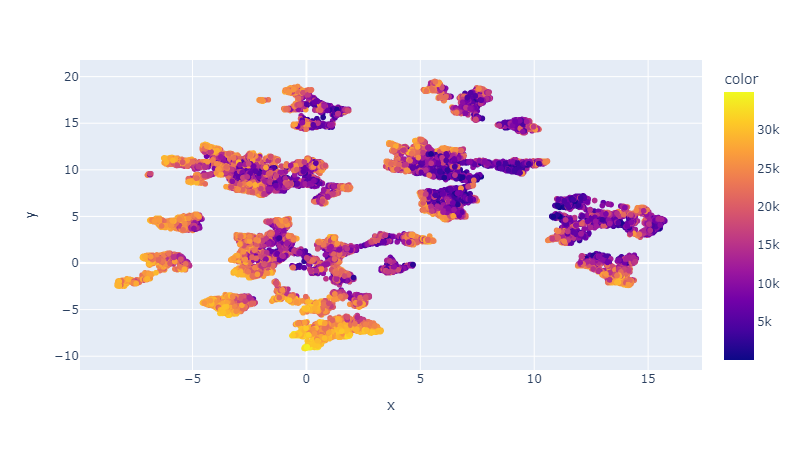

In [172]:
from IPython.display import Image

display(Image(filename='tree_embs.png'))

Добавим все эти три признака в модель (обучим её на параметрах после тюнинга, см. `best_params` в последнем разделе)

In [140]:
new_X_train_ = new_X_train
new_X_train_['x'] = embs_df['x']
new_X_train_['y'] = embs_df['y']
new_X_train_['count'] = embs_df['color']

In [ ]:
lgb_df = lgb.Dataset(data=new_X_train_, label=y_train, categorical_feature=new_cat_features)

model2 = lgb.train(
    params={
        'objective': 'regression',
        'num_leaves': 50,
        'learning_rate': 0.030107453196395864
    },
    train_set=lgb_df,
    num_boost_round=500
)

In [ ]:
leaf_matrix_test = model.predict(new_X_test, pred_leaf=True)
test_embs = extract_attr_by_leaf_matrix(leaf_df, leaf_matrix_test, 'count')
new_emb_test = mapper.transform(test_embs)
new_X_test_ = new_X_test
new_X_test_['x'] = new_emb_test['x']
new_X_test_['y'] = new_emb_test['y']
new_X_test_['count'] = new_emb_test['color']

In [ ]:
y_pred = model2.predict(new_X_test_)
pd.DataFrame(y_pred, columns=['target']).to_csv('interpret.csv', index=True, index_label='index')

## Понижение размерности

Попробуем понизить размерность исходных данных. Для этого предварительно сделаем `OneHotEncoding` категориальных признаков и всё отнормализуем.

In [155]:
from sklearn.preprocessing import OneHotEncoder, Normalizer
from sklearn.pipeline import Pipeline

ohe_encoder = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(handle_unknown='ignore', sparse_output=False), cat_features)
    ],
    remainder='passthrough'
)

normalizer = Normalizer()

preprocessing_pipeline = Pipeline([
    ('ohe', ohe_encoder),
    ('normalizer', normalizer)
])

normalized_train = preprocessing_pipeline.fit_transform(X_train)

После чего понизим размерность алгоритмом `umap`. Выберем `n_neighbors=50`, так как у нас около 100к объектов.

In [ ]:
mapper = umap.UMAP(
    n_components=3,
    n_neighbors=50,
    n_jobs=-1,
)

data_emb = mapper.fit_transform(normalized_train)
data_embs_df = pd.DataFrame({
    'x': data_emb[:,0],
    'y': data_emb[:,1],
    'z': data_emb[:,2],
    'color': np.array(y_train)
})

In [160]:
fig = px.scatter_3d(data_frame=data_embs_df, x='x', y='y', z='z', color='color')
fig.update_layout(width=800)

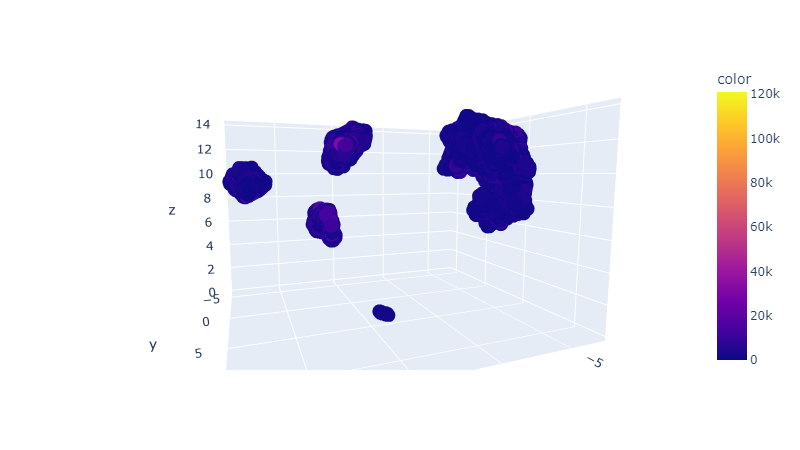

In [173]:
display(Image(filename='data_embs.png'))

Видно 5 кластеров, но раскраска по таргету в них примерно одинаковая. Кластеризацию не имеет смысла делать, поскольку модель градиентного бустинга сможет легко разделить данную область на кластеры обычными сплитами по новым переменным. Добавим полученные низкоразмерные эмбеддинги в модель.

In [161]:
new_X_train_['data_emb_x'] = data_embs_df['x']
new_X_train_['data_emb_y'] = data_embs_df['y']
new_X_train_['data_emb_z'] = data_embs_df['z']

In [ ]:
lgb_df = lgb.Dataset(data=new_X_train_, label=y_train, categorical_feature=new_cat_features)

model3 = lgb.train(
    train_set=lgb_df,
    params={
        'objective': 'regression',
        'num_leaves': 50,
        'learning_rate': 0.030107453196395864
    },
    num_boost_round=500
)

In [ ]:
normalized_test = preprocessing_pipeline.transform(X_test)
test_data_emb = mapper.transform(normalized_test)
new_X_test_['data_emb_x'] = test_data_emb[:,0]
new_X_test_['data_emb_y'] = test_data_emb[:,1]
new_X_test_['data_emb_z'] = test_data_emb[:,2]

y_pred = model3.predict(new_X_test_)
pd.DataFrame(y_pred, columns=['target']).to_csv('data_embs.csv', index=True, index_label='index')

Это не дало прирост скора.

# Подбор гиперпараметров

Перебирались параметры `num_leaves` и `learning_rate`. Оценка производилась следующим образом:
* делалась кросс-валидация по 5 фолдам;
* на каждом фолде считалась кастомная метрика;
* обучение производилось на 500 итерациях град. бустинга с early stopping по кастомной метрике;
* итог: среднее значение метрики по 5 фолдам.

In [ ]:
import optuna
from sklearn.model_selection import KFold

def objective(trial):
    params = {
        "objective": "regression",
        "num_leaves": trial.suggest_int("num_leaves", 10, 100),
        "learning_rate": trial.suggest_float("learning_rate", 0.01, 1, log=True),
    }

    n_splits = 5
    kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)
    scores = []

    for train_idx, valid_idx in kf.split(new_X_train):
        X_train_fold, X_valid_fold = new_X_train.iloc[train_idx], new_X_train.iloc[valid_idx]
        y_train_fold, y_valid_fold = y_train.iloc[train_idx], y_train.iloc[valid_idx]

        lgb_train = lgb.Dataset(
            X_train_fold, 
            label=y_train_fold, 
            categorical_feature=new_cat_features
        )
        lgb_valid = lgb.Dataset(
            X_valid_fold, 
            label=y_valid_fold, 
            categorical_feature=new_cat_features,
            reference=lgb_train
        )

        model = lgb.train(
            params=params,
            train_set=lgb_train,
            valid_sets=[lgb_valid],
            valid_names=['valid'],
            feval=custom_metric,
            callbacks=[
                lgb.log_evaluation(period=20),
                lgb.early_stopping(stopping_rounds=50, verbose=False)
            ],
            num_boost_round=500
        )

        valid_preds = model.predict(X_valid_fold)
        _, metric_value, _ = custom_metric(valid_preds, y_true=np.array(y_valid_fold))
        scores.append(metric_value)

    return np.mean(scores)

In [ ]:
study = optuna.create_study(direction="minimize")
study.optimize(objective, n_trials=50)

print("Лучшие параметры:", study.best_params)

In [ ]:
lgb_df = lgb.Dataset(data=new_X_train, label=y_train, categorical_feature=new_cat_features)
best_params = study.best_params

model = lgb.train(
    train_set=lgb_df, 
    params=best_params, 
    valid_sets=[lgb_df],
    valid_names=['train'], 
    feval=custom_metric,
    callbacks=[lgb.log_evaluation(period=20)],
    num_boost_round=500
)

In [123]:
best_params

{'num_leaves': 50, 'learning_rate': 0.030107453196395864}

In [ ]:
y_pred = model.predict(new_X_test)
pd.DataFrame(y_pred, columns=['target']).to_csv('tuned.csv', index=True, index_label='index')